In [162]:
import zipfile
import fnmatch
import os
import pandas as pd
import pyarrow as pa
import pyarrow.parquet as pq
import folium
from IPython.display import display
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import requests

In [163]:
parquet_file = r"C:\Users\bella\Downloads\Y2Q4 JBG050 Data Challenge 2\clean_df.parquet"
dataset = pd.read_parquet(parquet_file, engine='pyarrow')
pd.options.display.max_columns = None
print(dataset)

                                                   Crime ID    Month  \
2051                                                   None  2010-12   
2052                                                   None  2010-12   
2053                                                   None  2010-12   
2054                                                   None  2010-12   
2071                                                   None  2010-12   
...                                                     ...      ...   
13079989  fda0870be993d2c9352ae14a540bf529c15a7aa9d92a4e...  2023-03   
13079990  c6c2d9a772695865f4ca33fce59c26c48fe3a1cdac8c22...  2023-03   
13080002  e5bab2bd4f31de44515dbf125b85284392d0349139a1d3...  2023-03   
13080003  823465427f8764e250a48312715a4bd87e8012412046c6...  2023-03   
13080004  50b5bbf4987109ee189f8a736ec7e92365b25169b7f783...  2023-03   

                          Reported by                 Falls within  Longitude  \
2051      Metropolitan Police Service  Metropolitan Po

In [164]:
lat = dataset['Latitude'].mean()
long = dataset['Longitude'].mean()
centroid = Point(lat, long)

# Print the centroid coordinates
print("Centroid Latitude:", centroid.y)
print("Centroid Longitude:", centroid.x)

Centroid Latitude: -0.20462237076895193
Centroid Longitude: 51.60615920007704


<BarContainer object of 14 artists>

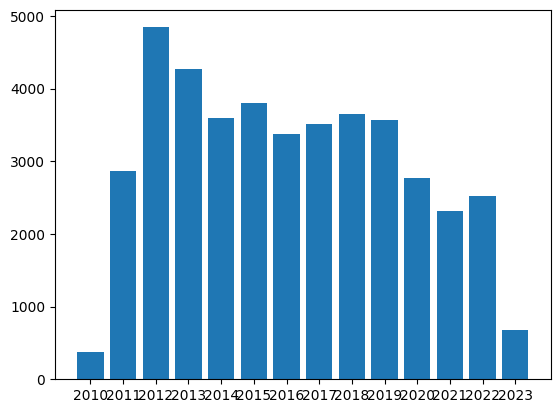

In [165]:
year = dataset.groupby(dataset['Month'].str[:4])
year_count = year['Reported by'].count()
plt.bar(year_count.index, year_count.values)

<BarContainer object of 12 artists>

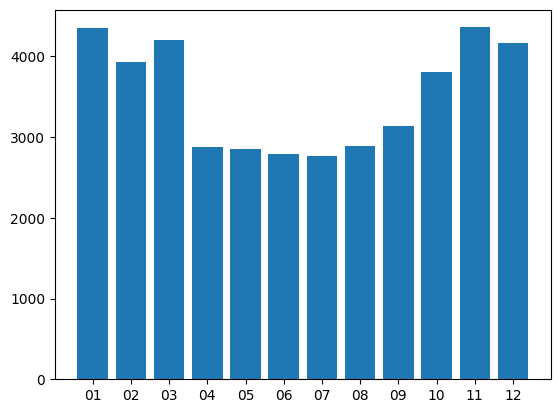

In [166]:
month = dataset.groupby(dataset['Month'].str[-2:])
month_count = month['Reported by'].count()
plt.bar(month_count.index, month_count.values)

In [167]:
locations = list(zip(dataset.Latitude, dataset.Longitude))

m = folium.Map(location= [51.60615920007704, -0.20462237076895193],width="%100",height="%100", zoom_start=11,min_zoom=10,max_zoom=14)
for i in range(len(locations)):
    folium.CircleMarker(location=locations[i],radius=1).add_to(m)
m

In [168]:
geometry = dataset.apply(lambda row: Point(row['Longitude'], row['Latitude']), axis=1)
gdf = gpd.GeoDataFrame(dataset, geometry=geometry)
print(gdf.head())

     Crime ID    Month                  Reported by  \
2051     None  2010-12  Metropolitan Police Service   
2052     None  2010-12  Metropolitan Police Service   
2053     None  2010-12  Metropolitan Police Service   
2054     None  2010-12  Metropolitan Police Service   
2071     None  2010-12  Metropolitan Police Service   

                     Falls within  Longitude   Latitude  \
2051  Metropolitan Police Service  -0.201877  51.655538   
2052  Metropolitan Police Service  -0.207853  51.654317   
2053  Metropolitan Police Service  -0.202510  51.656348   
2054  Metropolitan Police Service  -0.206779  51.654768   
2071  Metropolitan Police Service  -0.209537  51.655223   

                      Location  LSOA code    LSOA name Crime type  \
2051    On or near High Street  E01000248  Barnet 001A   Burglary   
2052     On or near The Avenue  E01000248  Barnet 001A   Burglary   
2053     On or near Bruce Road  E01000248  Barnet 001A   Burglary   
2054      On or near The Drive  E01000

In [169]:
# os.environ['SHAPE_RESTORE_SHX'] = 'YES'

In [170]:
# Load the shapefiles for the borough and wards
borough = gpd.read_file(r'C:\Users\bella\Downloads\Y2Q4 JBG050 Data Challenge 2\London-wards-2018_ESRI\London_Ward.shp')

In [171]:
type(borough)

geopandas.geodataframe.GeoDataFrame

In [172]:
print(borough)

                       NAME   GSS_CODE                               DISTRICT  \
0         Chessington South  E05000405                   Kingston upon Thames   
1    Tolworth and Hook Rise  E05000414                   Kingston upon Thames   
2                Berrylands  E05000401                   Kingston upon Thames   
3                 Alexandra  E05000400                   Kingston upon Thames   
4                  Beverley  E05000402                   Kingston upon Thames   
..                      ...        ...                                    ...   
652                 Aldgate  E05009289  City and County of the City of London   
653            Broad Street  E05009295  City and County of the City of London   
654          Coleman Street  E05009299  City and County of the City of London   
655               Portsoken  E05009308  City and County of the City of London   
656              Candlewick  E05009296  City and County of the City of London   

     LAGSSCODE  HECTARES  N

In [173]:
barnet = borough[borough['DISTRICT'].str.contains('Barnet')==True]
print(barnet, type(barnet), len(barnet))

                    NAME   GSS_CODE DISTRICT  LAGSSCODE  HECTARES  NONLD_AREA  \
191            Underhill  E05000060   Barnet  E09000003   455.053         0.0   
192          High Barnet  E05000056   Barnet  E09000003   830.666         0.0   
193          West Hendon  E05000062   Barnet  E09000003   342.865         0.0   
194        Golders Green  E05000053   Barnet  E09000003   297.292         0.0   
195            Colindale  E05000046   Barnet  E09000003   263.627         0.0   
196          Childs Hill  E05000045   Barnet  E09000003   309.301         0.0   
197        Garden Suburb  E05000052   Barnet  E09000003   472.705         0.0   
198  Finchley Church End  E05000051   Barnet  E09000003   272.564         0.0   
199        East Finchley  E05000049   Barnet  E09000003   250.989         0.0   
200              Edgware  E05000050   Barnet  E09000003   555.652         0.0   
201            Mill Hill  E05000057   Barnet  E09000003   938.921         0.0   
202                 Hale  E0

In [193]:
import requests

# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/neighbourhoods'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

<Response [200]>
[{'id': 'E05009317', 'name': 'Bethnal Green East'}, {'id': 'E05009318', 'name': 'Blackwall and Cubitt Town'}, {'id': 'E05009319', 'name': 'Bow East'}, {'id': 'E05009320', 'name': 'Bow West'}, {'id': 'E05009321', 'name': 'Bromley North'}, {'id': 'E05009322', 'name': 'Bromley South'}, {'id': 'E05009323', 'name': 'Canary Wharf'}, {'id': 'E05009324', 'name': 'Island Gardens'}, {'id': 'E05009325', 'name': 'Lansbury'}, {'id': 'E05009326', 'name': 'Limehouse'}, {'id': 'E05009327', 'name': 'Mile End'}, {'id': 'E05009328', 'name': 'Poplar'}, {'id': 'E05009329', 'name': "St Dunstan's"}, {'id': 'E05009330', 'name': "St Katharine's and Wapping"}, {'id': 'E05009331', 'name': 'Bethnal Green West'}, {'id': 'E05009332', 'name': 'Shadwell'}, {'id': 'E05009333', 'name': 'Spitalfields and Banglatown'}, {'id': 'E05009334', 'name': 'Stepney Green'}, {'id': 'E05009335', 'name': 'Weavers'}, {'id': 'E05009336', 'name': 'Whitechapel'}, {'id': 'E05009367', 'name': 'Brownswood'}, {'id': 'E050093

In [194]:
# Find dictionaries where 'location' value contains 'ward name'
burnt_oak = [d for d in response.json() if 'Burnt Oak' in d.get('name', '')]
barnet_vale = [d for d in response.json() if 'Barnet Vale' in d.get('name', '')]
brunswick_park = [d for d in response.json() if 'Brunswick Park' in d.get('name', '')]
childs_hill = [d for d in response.json() if 'Childs Hill' in d.get('name', '')]
colindale_north = [d for d in response.json() if 'Colindale North' in d.get('name', '')]
colindale_south = [d for d in response.json() if 'Colindale South' in d.get('name', '')]
cricklewood = [d for d in response.json() if 'Cricklewood' in d.get('name', '')]
east_barnet = [d for d in response.json() if 'East Barnet' in d.get('name', '')]
east_finchley = [d for d in response.json() if 'East Finchley' in d.get('name', '')]
edgware = [d for d in response.json() if 'Edgware' in d.get('name', '')]
edgwarebury = [d for d in response.json() if 'Edgwarebury' in d.get('name', '')]
finchley_church_end = [d for d in response.json() if 'Finchley Church End' in d.get('name', '')]
friern_barnet = [d for d in response.json() if 'Friern Barnet' in d.get('name', '')]
garden_suburb = [d for d in response.json() if 'Garden Suburb' in d.get('name', '')]
golders_green = [d for d in response.json() if 'Golders Green' in d.get('name', '')]
hendon = [d for d in response.json() if 'Hendon' in d.get('name', '')]
high_barnet = [d for d in response.json() if 'High Barnet' in d.get('name', '')]
mill_hill = [d for d in response.json() if 'Mill Hill' in d.get('name', '')]
totteridge_woodside = [d for d in response.json() if 'Totteridge' in d.get('name', '')]
underhill = [d for d in response.json() if 'Underhill' in d.get('name', '')] 
west_finchley = [d for d in response.json() if 'West Finchley' in d.get('name', '')]
west_hendon = [d for d in response.json() if 'West Hendon' in d.get('name', '')]
whetstone = [d for d in response.json() if 'Whetstone' in d.get('name', '')]
woodhouse = [d for d in response.json() if 'Woodhouse' in d.get('name', '')]

In [196]:
barnet = []
barnet = burnt_oak + barnet_vale + brunswick_park + childs_hill + colindale_north + colindale_south + cricklewood + east_barnet+ east_finchley + edgware + edgwarebury + finchley_church_end + friern_barnet + garden_suburb + golders_green + hendon + high_barnet + mill_hill + totteridge_woodside + underhill + west_finchley + west_hendon + whetstone + woodhouse
# Print matching dictionaries
for d in barnet:
    print(d)

len(barnet)

{'id': 'E05013630', 'name': 'Burnt Oak'}
{'id': 'E05013628', 'name': 'Barnet Vale'}
{'id': 'E05013629', 'name': 'Brunswick Park'}
{'id': 'E05013631', 'name': 'Childs Hill'}
{'id': 'E05013632', 'name': 'Colindale North'}
{'id': 'E05013633', 'name': 'Colindale South'}
{'id': 'E05013499', 'name': 'Cricklewood and Mapesbury'}
{'id': 'E05013634', 'name': 'Cricklewood'}
{'id': 'E05013635', 'name': 'East Barnet'}
{'id': 'E05013636', 'name': 'East Finchley'}
{'id': 'E05013545', 'name': 'Edgware'}
{'id': 'E05013637', 'name': 'Edgware'}
{'id': 'E05013638', 'name': 'Edgwarebury'}
{'id': 'E05013638', 'name': 'Edgwarebury'}
{'id': 'E05013639', 'name': 'Finchley Church End'}
{'id': 'E05013640', 'name': 'Friern Barnet'}
{'id': 'E05013641', 'name': 'Garden Suburb'}
{'id': 'E05013642', 'name': 'Golders Green'}
{'id': 'E05013643', 'name': 'Hendon'}
{'id': 'E05013649', 'name': 'West Hendon'}
{'id': 'E05013644', 'name': 'High Barnet'}
{'id': 'E05013645', 'name': 'Mill Hill'}
{'id': 'E05013646', 'name': 'T

28

In [262]:
# make list of id
df_w = pd.DataFrame(barnet)
df_w.set_index("id", inplace= True)
df_w.drop_duplicates(inplace=True)
df_w.drop(index="E05013499", inplace=True)
df_w.head()

,name
id,
E05013630,Burnt Oak
E05013628,Barnet Vale
E05013629,Brunswick Park
E05013631,Childs Hill
E05013632,Colindale North


In [264]:
def get_boundaries(x):
    url = f'https://data.police.uk/api/metropolitan/{x.name}/boundary'
    response = requests.get(url)
    bound_list = [(float(point['latitude']), float(point['longitude'])) for point in response.json()]

    return bound_list

df_w["boundaries"] = df_w.apply(get_boundaries(x))

AttributeError: 'GeoDataFrame' object has no attribute 'name'

In [177]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013630/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_burnt_oak = response.json()
print(len(coord_burnt_oak))

coords_bo = [[float(point['latitude']), float(point['longitude'])] for point in coord_burnt_oak]
print(coords_bo)
print(len(coords_bo))

<Response [200]>
[{'latitude': '51.597724278003', 'longitude': '-0.25291781885811'}, {'latitude': '51.597690267696', 'longitude': '-0.25298308769192'}, {'latitude': '51.597680886469', 'longitude': '-0.253047701184'}, {'latitude': '51.597663973303', 'longitude': '-0.25311982287324'}, {'latitude': '51.597638671533', 'longitude': '-0.25317205132564'}, {'latitude': '51.597599290374', 'longitude': '-0.2532450340001'}, {'latitude': '51.597564680632', 'longitude': '-0.25330628245752'}, {'latitude': '51.597520569267', 'longitude': '-0.25333324128361'}, {'latitude': '51.597476001517', 'longitude': '-0.2535111052473'}, {'latitude': '51.597462372872', 'longitude': '-0.25359248594691'}, {'latitude': '51.597426158382', 'longitude': '-0.25366679054956'}, {'latitude': '51.597388799347', 'longitude': '-0.25375485592598'}, {'latitude': '51.59733452596', 'longitude': '-0.25388472025218'}, {'latitude': '51.597303232795', 'longitude': '-0.25395739198921'}, {'latitude': '51.59726695379', 'longitude': '-0.2

In [178]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013628/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_barnet_vale = response.json()
print(len(coord_barnet_vale))

coords_bv = [[float(point['latitude']), float(point['longitude'])] for point in coord_barnet_vale]
print(coords_bv)
print(len(coords_bv))

<Response [200]>
[{'latitude': '51.634276016337', 'longitude': '-0.17977180627771'}, {'latitude': '51.634323559716', 'longitude': '-0.17979738705934'}, {'latitude': '51.634449971404', 'longitude': '-0.17987147006744'}, {'latitude': '51.634539649382', 'longitude': '-0.17992409144152'}, {'latitude': '51.634673374018', 'longitude': '-0.1800093416517'}, {'latitude': '51.634770356225', 'longitude': '-0.18007256686475'}, {'latitude': '51.63487132762', 'longitude': '-0.18013963544833'}, {'latitude': '51.634998050065', 'longitude': '-0.18023377992417'}, {'latitude': '51.635047426324', 'longitude': '-0.18026506849148'}, {'latitude': '51.63517131756', 'longitude': '-0.18036046863937'}, {'latitude': '51.635296708797', 'longitude': '-0.18046040461227'}, {'latitude': '51.635416628354', 'longitude': '-0.18055310352012'}, {'latitude': '51.635559272349', 'longitude': '-0.1806609481544'}, {'latitude': '51.6356766489', 'longitude': '-0.18075087415535'}, {'latitude': '51.635831234062', 'longitude': '-0.1

In [179]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013629/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_brunswick_park = response.json()
print(len(coord_brunswick_park))

coords_bp = [[float(point['latitude']), float(point['longitude'])] for point in coord_brunswick_park]
print(coords_bp)
print(len(coords_bp))

<Response [200]>
[{'latitude': '51.627511902482', 'longitude': '-0.15625171052302'}, {'latitude': '51.627549008291', 'longitude': '-0.15632176850962'}, {'latitude': '51.627705332904', 'longitude': '-0.15625546625215'}, {'latitude': '51.627842422933', 'longitude': '-0.1563958354983'}, {'latitude': '51.627981060597', 'longitude': '-0.1565351314051'}, {'latitude': '51.628028062671', 'longitude': '-0.15658259591838'}, {'latitude': '51.62811610782', 'longitude': '-0.15667370684233'}, {'latitude': '51.628192441401', 'longitude': '-0.15674570069423'}, {'latitude': '51.628233222503', 'longitude': '-0.15679099054464'}, {'latitude': '51.628272375377', 'longitude': '-0.15683280657822'}, {'latitude': '51.628310980589', 'longitude': '-0.15687525173615'}, {'latitude': '51.628368390094', 'longitude': '-0.15693438847034'}, {'latitude': '51.628426418741', 'longitude': '-0.15699344245059'}, {'latitude': '51.628460178825', 'longitude': '-0.15704287525186'}, {'latitude': '51.62853023002', 'longitude': '-0

In [180]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013631/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_childs_hill = response.json()
print(len(coord_childs_hill))

coords_ch = [[float(point['latitude']), float(point['longitude'])] for point in coord_childs_hill]
print(coords_ch)
print(len(coords_ch))

<Response [200]>
[{'latitude': '51.559882977663', 'longitude': '-0.19691984536718'}, {'latitude': '51.559870194732', 'longitude': '-0.1969072655769'}, {'latitude': '51.559870619692', 'longitude': '-0.19681793121085'}, {'latitude': '51.559595051258', 'longitude': '-0.19679266077417'}, {'latitude': '51.559391907216', 'longitude': '-0.19674157327786'}, {'latitude': '51.559234150092', 'longitude': '-0.19665550956375'}, {'latitude': '51.559185924323', 'longitude': '-0.19679301423578'}, {'latitude': '51.559110146029', 'longitude': '-0.19700952707919'}, {'latitude': '51.559015967786', 'longitude': '-0.19732192539799'}, {'latitude': '51.558915024718', 'longitude': '-0.1975394313104'}, {'latitude': '51.558881770808', 'longitude': '-0.19759855357809'}, {'latitude': '51.559118459363', 'longitude': '-0.19795996533381'}, {'latitude': '51.558943248657', 'longitude': '-0.19820632988255'}, {'latitude': '51.558761776215', 'longitude': '-0.19845436639547'}, {'latitude': '51.558450952597', 'longitude': '

In [181]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013632/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_colindale_north = response.json()
print(len(coord_colindale_north))

coords_cn = [[float(point['latitude']), float(point['longitude'])] for point in coord_colindale_north]
print(coords_cn)
print(len(coords_cn))

<Response [200]>
[{'latitude': '51.597724278003', 'longitude': '-0.25291781885811'}, {'latitude': '51.597881574343', 'longitude': '-0.25311779246266'}, {'latitude': '51.597988400794', 'longitude': '-0.25326174278592'}, {'latitude': '51.59812249736', 'longitude': '-0.25343998144981'}, {'latitude': '51.598239115392', 'longitude': '-0.2536026611548'}, {'latitude': '51.598359428402', 'longitude': '-0.25377377702272'}, {'latitude': '51.5984495957', 'longitude': '-0.25391741553227'}, {'latitude': '51.598546438124', 'longitude': '-0.25407034327601'}, {'latitude': '51.598641557455', 'longitude': '-0.2542271496447'}, {'latitude': '51.598725181556', 'longitude': '-0.25437104049762'}, {'latitude': '51.598794744225', 'longitude': '-0.25448966716764'}, {'latitude': '51.5989286587', 'longitude': '-0.25473574146505'}, {'latitude': '51.59905718269', 'longitude': '-0.25497915009813'}, {'latitude': '51.599120225221', 'longitude': '-0.25509898114516'}, {'latitude': '51.599149709134', 'longitude': '-0.255

In [182]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013633/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_colindale_south = response.json()
print(len(coord_colindale_south))

coords_cs = [[float(point['latitude']), float(point['longitude'])] for point in coord_colindale_south]
print(coords_cs)
print(len(coords_cs))

<Response [200]>
[{'latitude': '51.597724278003', 'longitude': '-0.25291781885811'}, {'latitude': '51.597659615115', 'longitude': '-0.25283857240502'}, {'latitude': '51.597603201251', 'longitude': '-0.25276377482279'}, {'latitude': '51.597523518418', 'longitude': '-0.25266618947764'}, {'latitude': '51.59744536118', 'longitude': '-0.25256840157962'}, {'latitude': '51.597393526707', 'longitude': '-0.25250526904986'}, {'latitude': '51.597323601472', 'longitude': '-0.2524168401549'}, {'latitude': '51.597035822173', 'longitude': '-0.25206415893372'}, {'latitude': '51.596874293874', 'longitude': '-0.25186272311972'}, {'latitude': '51.596708369879', 'longitude': '-0.25165597055299'}, {'latitude': '51.596515659259', 'longitude': '-0.2514137179568'}, {'latitude': '51.596229259307', 'longitude': '-0.25105738835442'}, {'latitude': '51.59614455582', 'longitude': '-0.2509549051614'}, {'latitude': '51.596044700521', 'longitude': '-0.25083189471863'}, {'latitude': '51.595915332458', 'longitude': '-0.

In [183]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013499/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_cricklewood_mapesbury= response.json()
print(len(coord_cricklewood_mapesbury))

coords_cm = [[float(point['latitude']), float(point['longitude'])] for point in coord_cricklewood_mapesbury]
print(coords_cm)
print(len(coords_cm))

<Response [200]>
[{'latitude': '51.550418761286', 'longitude': '-0.20750388702063'}, {'latitude': '51.550255133471', 'longitude': '-0.20728443085853'}, {'latitude': '51.550195478477', 'longitude': '-0.20723570256338'}, {'latitude': '51.550187774438', 'longitude': '-0.20722939949135'}, {'latitude': '51.550132849605', 'longitude': '-0.20716066704314'}, {'latitude': '51.549835735366', 'longitude': '-0.20678882835349'}, {'latitude': '51.549420118604', 'longitude': '-0.20631189433604'}, {'latitude': '51.548986308708', 'longitude': '-0.205839723558'}, {'latitude': '51.548897092024', 'longitude': '-0.20574261780449'}, {'latitude': '51.548292122717', 'longitude': '-0.2051116619194'}, {'latitude': '51.547490204692', 'longitude': '-0.20424754519108'}, {'latitude': '51.547482882139', 'longitude': '-0.2042391510562'}, {'latitude': '51.546959594953', 'longitude': '-0.20371168600436'}, {'latitude': '51.546839702746', 'longitude': '-0.2035910913281'}, {'latitude': '51.546813408021', 'longitude': '-0.

In [184]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013634/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_cricklewood= response.json()
print(len(coord_cricklewood))

coords_c = [[float(point['latitude']), float(point['longitude'])] for point in coord_cricklewood]
print(coords_c)
print(len(coords_c))

<Response [200]>
[{'latitude': '51.556035194017', 'longitude': '-0.20921111227133'}, {'latitude': '51.556036267315', 'longitude': '-0.2092124982873'}, {'latitude': '51.556332239607', 'longitude': '-0.209513935515'}, {'latitude': '51.556356036516', 'longitude': '-0.20954178109151'}, {'latitude': '51.556748574858', 'longitude': '-0.20999787313694'}, {'latitude': '51.556752429117', 'longitude': '-0.21000235263947'}, {'latitude': '51.556756089364', 'longitude': '-0.21000649353311'}, {'latitude': '51.556465505548', 'longitude': '-0.21081987730279'}, {'latitude': '51.556324133795', 'longitude': '-0.21122224256527'}, {'latitude': '51.55615741074', 'longitude': '-0.21167301595979'}, {'latitude': '51.555926647028', 'longitude': '-0.21210477215863'}, {'latitude': '51.555704938921', 'longitude': '-0.21248705039044'}, {'latitude': '51.555422808323', 'longitude': '-0.21297564072052'}, {'latitude': '51.555290496745', 'longitude': '-0.2132606887362'}, {'latitude': '51.555277716744', 'longitude': '-0.

In [185]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013635/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_east_barnet= response.json()
print(len(coord_east_barnet))

coords_eb = [[float(point['latitude']), float(point['longitude'])] for point in coord_east_barnet]
print(coords_eb)
print(len(coords_eb))

<Response [200]>
[{'latitude': '51.660577323544', 'longitude': '-0.17555928061237'}, {'latitude': '51.660571030584', 'longitude': '-0.17552872125642'}, {'latitude': '51.65988965912', 'longitude': '-0.17245918990238'}, {'latitude': '51.6598883438', 'longitude': '-0.17245325688204'}, {'latitude': '51.658227436881', 'longitude': '-0.16501620834145'}, {'latitude': '51.658169237308', 'longitude': '-0.16347886648883'}, {'latitude': '51.658090217676', 'longitude': '-0.16326080588965'}, {'latitude': '51.658054747525', 'longitude': '-0.16311570595162'}, {'latitude': '51.657966320289', 'longitude': '-0.16275392297436'}, {'latitude': '51.657333578676', 'longitude': '-0.16158850961379'}, {'latitude': '51.657218186856', 'longitude': '-0.16137598975254'}, {'latitude': '51.656987579268', 'longitude': '-0.16095020875677'}, {'latitude': '51.656805697928', 'longitude': '-0.16059315889262'}, {'latitude': '51.656753729258', 'longitude': '-0.16048976352483'}, {'latitude': '51.656257734393', 'longitude': '-

In [186]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013636/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_east_finchley = response.json()
print(len(coord_east_finchley))

coords_ef = [[float(point['latitude']), float(point['longitude'])] for point in coord_east_finchley]
print(coords_ef)
print(len(coords_ef))

<Response [200]>
[{'latitude': '51.585010431289', 'longitude': '-0.16056060454078'}, {'latitude': '51.585192260011', 'longitude': '-0.16083100664881'}, {'latitude': '51.585355438537', 'longitude': '-0.16108423540589'}, {'latitude': '51.58535784934', 'longitude': '-0.16118704577597'}, {'latitude': '51.585358113204', 'longitude': '-0.16119815013694'}, {'latitude': '51.585279839711', 'longitude': '-0.16131908537785'}, {'latitude': '51.585347578097', 'longitude': '-0.16144470790539'}, {'latitude': '51.58538928382', 'longitude': '-0.16152386112171'}, {'latitude': '51.585420765157', 'longitude': '-0.16158177446397'}, {'latitude': '51.58545221258', 'longitude': '-0.16163752398762'}, {'latitude': '51.587106021867', 'longitude': '-0.16466072521799'}, {'latitude': '51.587380868662', 'longitude': '-0.16515778800134'}, {'latitude': '51.587470195791', 'longitude': '-0.16532092253919'}, {'latitude': '51.58756172432', 'longitude': '-0.16548108189368'}, {'latitude': '51.587657341803', 'longitude': '-0

In [187]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013636/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_east_finchley = response.json()
print(len(coord_east_finchley))

coords_ef = [[float(point['latitude']), float(point['longitude'])] for point in coord_east_finchley]
print(coords_ef)
print(len(coords_ef))

<Response [200]>
[{'latitude': '51.585010431289', 'longitude': '-0.16056060454078'}, {'latitude': '51.585192260011', 'longitude': '-0.16083100664881'}, {'latitude': '51.585355438537', 'longitude': '-0.16108423540589'}, {'latitude': '51.58535784934', 'longitude': '-0.16118704577597'}, {'latitude': '51.585358113204', 'longitude': '-0.16119815013694'}, {'latitude': '51.585279839711', 'longitude': '-0.16131908537785'}, {'latitude': '51.585347578097', 'longitude': '-0.16144470790539'}, {'latitude': '51.58538928382', 'longitude': '-0.16152386112171'}, {'latitude': '51.585420765157', 'longitude': '-0.16158177446397'}, {'latitude': '51.58545221258', 'longitude': '-0.16163752398762'}, {'latitude': '51.587106021867', 'longitude': '-0.16466072521799'}, {'latitude': '51.587380868662', 'longitude': '-0.16515778800134'}, {'latitude': '51.587470195791', 'longitude': '-0.16532092253919'}, {'latitude': '51.58756172432', 'longitude': '-0.16548108189368'}, {'latitude': '51.587657341803', 'longitude': '-0

In [197]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013545/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_edgware = response.json()
print(len(coord_edgware))

coords_edg = [[float(point['latitude']), float(point['longitude'])] for point in coord_edgware]
print(coords_edg)
print(len(coords_edg))

<Response [200]>
[{'latitude': '51.612277994295', 'longitude': '-0.28101069219112'}, {'latitude': '51.611447326071', 'longitude': '-0.2801331319748'}, {'latitude': '51.611441717919', 'longitude': '-0.28012720564826'}, {'latitude': '51.611437457247', 'longitude': '-0.28012241272775'}, {'latitude': '51.610745940797', 'longitude': '-0.27934470300914'}, {'latitude': '51.610722158627', 'longitude': '-0.27931665873149'}, {'latitude': '51.610158605368', 'longitude': '-0.27872267679481'}, {'latitude': '51.609813347377', 'longitude': '-0.2783413922219'}, {'latitude': '51.609799865409', 'longitude': '-0.27832650632987'}, {'latitude': '51.609785853284', 'longitude': '-0.27831103390755'}, {'latitude': '51.609426491227', 'longitude': '-0.27791418423473'}, {'latitude': '51.609360136997', 'longitude': '-0.27783754954951'}, {'latitude': '51.608887689263', 'longitude': '-0.27729189550507'}, {'latitude': '51.608757140363', 'longitude': '-0.27713499261887'}, {'latitude': '51.608738522047', 'longitude': '

In [204]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013637/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_edgware1 = response.json()
print(len(coord_edgware1))

coords_edg1 = [[float(point['latitude']), float(point['longitude'])] for point in coord_edgware1]
print(coords_edg1)
print(len(coords_edg1))

<Response [200]>
[{'latitude': '51.612277994295', 'longitude': '-0.28101069219112'}, {'latitude': '51.612699350932', 'longitude': '-0.28145583288776'}, {'latitude': '51.612702173287', 'longitude': '-0.28145881715006'}, {'latitude': '51.613358326458', 'longitude': '-0.28217642659224'}, {'latitude': '51.614294208721', 'longitude': '-0.28338901858045'}, {'latitude': '51.614650250934', 'longitude': '-0.28393887159983'}, {'latitude': '51.614783061918', 'longitude': '-0.28416215805624'}, {'latitude': '51.614914903002', 'longitude': '-0.28438678200704'}, {'latitude': '51.614980640127', 'longitude': '-0.28450500872025'}, {'latitude': '51.61541365775', 'longitude': '-0.2852837841475'}, {'latitude': '51.615827239505', 'longitude': '-0.28587790580192'}, {'latitude': '51.615898591485', 'longitude': '-0.28598041315933'}, {'latitude': '51.616527331637', 'longitude': '-0.28672951843316'}, {'latitude': '51.616610588594', 'longitude': '-0.28682892253985'}, {'latitude': '51.617154288223', 'longitude': '

In [205]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013638/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_edgwarebury = response.json()
print(len(coord_edgwarebury))

coords_edgb = [[float(point['latitude']), float(point['longitude'])] for point in coord_edgwarebury]
print(coords_edgb)
print(len(coords_edgb))

<Response [200]>
[{'latitude': '51.637331741599', 'longitude': '-0.23724979464058'}, {'latitude': '51.637275139555', 'longitude': '-0.23722308601195'}, {'latitude': '51.637230350601', 'longitude': '-0.23720459042535'}, {'latitude': '51.637189627462', 'longitude': '-0.23718738236911'}, {'latitude': '51.637143181934', 'longitude': '-0.23717834482285'}, {'latitude': '51.636991317724', 'longitude': '-0.23715533112368'}, {'latitude': '51.636850389572', 'longitude': '-0.23714200965692'}, {'latitude': '51.636648176531', 'longitude': '-0.23711950379422'}, {'latitude': '51.636580633235', 'longitude': '-0.23711272985045'}, {'latitude': '51.636441415846', 'longitude': '-0.23709356154633'}, {'latitude': '51.636303172985', 'longitude': '-0.2370794136175'}, {'latitude': '51.63625494091', 'longitude': '-0.23707116817828'}, {'latitude': '51.636169743003', 'longitude': '-0.2370564081133'}, {'latitude': '51.636111175884', 'longitude': '-0.23704856356887'}, {'latitude': '51.636066966299', 'longitude': '-

In [207]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013639/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_finchley_church_end = response.json()
print(len(coord_finchley_church_end))

coords_fce = [[float(point['latitude']), float(point['longitude'])] for point in coord_finchley_church_end]
print(coords_fce)
print(len(coords_fce))

<Response [200]>
[{'latitude': '51.598944782652', 'longitude': '-0.22560824087028'}, {'latitude': '51.598992389873', 'longitude': '-0.22557505380654'}, {'latitude': '51.599057079836', 'longitude': '-0.22552979439128'}, {'latitude': '51.599107354782', 'longitude': '-0.2254946261536'}, {'latitude': '51.59930134119', 'longitude': '-0.22535928319779'}, {'latitude': '51.599339110607', 'longitude': '-0.22532965541402'}, {'latitude': '51.599406844733', 'longitude': '-0.22528947485615'}, {'latitude': '51.599448311489', 'longitude': '-0.22526648942507'}, {'latitude': '51.59943158706', 'longitude': '-0.22520115296422'}, {'latitude': '51.59940147776', 'longitude': '-0.22508320112243'}, {'latitude': '51.599367653508', 'longitude': '-0.22495745252954'}, {'latitude': '51.599282396438', 'longitude': '-0.22464166509584'}, {'latitude': '51.599266338395', 'longitude': '-0.22450150751568'}, {'latitude': '51.599238222264', 'longitude': '-0.22439647428807'}, {'latitude': '51.599226297225', 'longitude': '-0

In [209]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013640/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_friern_barnet = response.json()
print(len(coord_friern_barnet))

coords_fb = [[float(point['latitude']), float(point['longitude'])] for point in coord_friern_barnet]
print(coords_fb)
print(len(coords_fb))

<Response [200]>
[{'latitude': '51.627511902482', 'longitude': '-0.15625171052302'}, {'latitude': '51.627353560235', 'longitude': '-0.1561014118987'}, {'latitude': '51.625807312069', 'longitude': '-0.15458425881824'}, {'latitude': '51.625483145037', 'longitude': '-0.15427017680003'}, {'latitude': '51.624751543561', 'longitude': '-0.15355077707901'}, {'latitude': '51.624404419256', 'longitude': '-0.15320658061834'}, {'latitude': '51.623973356121', 'longitude': '-0.15278561779095'}, {'latitude': '51.623492405359', 'longitude': '-0.15230890217335'}, {'latitude': '51.622878640096', 'longitude': '-0.15170685169344'}, {'latitude': '51.622772975825', 'longitude': '-0.15160380735561'}, {'latitude': '51.622661741086', 'longitude': '-0.15149535661599'}, {'latitude': '51.622073499', 'longitude': '-0.15091541112795'}, {'latitude': '51.621240602719', 'longitude': '-0.15010346150595'}, {'latitude': '51.616673872387', 'longitude': '-0.14563229740563'}, {'latitude': '51.616633043313', 'longitude': '-0

In [211]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013641/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_garden_suburb = response.json()
print(len(coord_garden_suburb))

coords_gs = [[float(point['latitude']), float(point['longitude'])] for point in coord_garden_suburb]
print(coords_gs)
print(len(coords_gs))

<Response [200]>
[{'latitude': '51.589778519051', 'longitude': '-0.19980069833419'}, {'latitude': '51.589780496666', 'longitude': '-0.19970928424414'}, {'latitude': '51.5897813589', 'longitude': '-0.19961902585584'}, {'latitude': '51.589784861791', 'longitude': '-0.19952505396877'}, {'latitude': '51.589784874316', 'longitude': '-0.19946730993975'}, {'latitude': '51.589782703056', 'longitude': '-0.19932592423446'}, {'latitude': '51.589780957514', 'longitude': '-0.19924154342194'}, {'latitude': '51.589778124858', 'longitude': '-0.1991449351541'}, {'latitude': '51.58977707845', 'longitude': '-0.19904753438045'}, {'latitude': '51.589774872276', 'longitude': '-0.19896245002935'}, {'latitude': '51.589770530091', 'longitude': '-0.19888466820276'}, {'latitude': '51.589754101835', 'longitude': '-0.19869332155182'}, {'latitude': '51.589739209741', 'longitude': '-0.19851418468013'}, {'latitude': '51.589719497293', 'longitude': '-0.19828471330651'}, {'latitude': '51.589694492675', 'longitude': '-0

In [213]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013642/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_golders_green = response.json()
print(len(coord_golders_green))

coords_gg = [[float(point['latitude']), float(point['longitude'])] for point in coord_golders_green]
print(coords_gg)
print(len(coords_gg))

<Response [200]>
[{'latitude': '51.589778519051', 'longitude': '-0.19980069833419'}, {'latitude': '51.589609531746', 'longitude': '-0.1997895580241'}, {'latitude': '51.589310204535', 'longitude': '-0.19978117985726'}, {'latitude': '51.589256038205', 'longitude': '-0.19977854534487'}, {'latitude': '51.588965616109', 'longitude': '-0.19980723198731'}, {'latitude': '51.588698125992', 'longitude': '-0.19982076281967'}, {'latitude': '51.588510429905', 'longitude': '-0.19982046783513'}, {'latitude': '51.588507984588', 'longitude': '-0.19963075224029'}, {'latitude': '51.588504701428', 'longitude': '-0.19933906859584'}, {'latitude': '51.588501616195', 'longitude': '-0.19904509633604'}, {'latitude': '51.588460095654', 'longitude': '-0.19904554201931'}, {'latitude': '51.588281691833', 'longitude': '-0.19905188334636'}, {'latitude': '51.588216480395', 'longitude': '-0.19905085623113'}, {'latitude': '51.588167939299', 'longitude': '-0.19905205621339'}, {'latitude': '51.588120307986', 'longitude': 

In [215]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013643/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_hendon = response.json()
print(len(coord_hendon))

coords_h = [[float(point['latitude']), float(point['longitude'])] for point in coord_hendon]
print(coords_h)
print(len(coords_h))

<Response [200]>
[{'latitude': '51.598944782652', 'longitude': '-0.22560824087028'}, {'latitude': '51.598916380447', 'longitude': '-0.22550206371862'}, {'latitude': '51.598656392327', 'longitude': '-0.2245433247243'}, {'latitude': '51.598401972606', 'longitude': '-0.22362625309896'}, {'latitude': '51.598334046253', 'longitude': '-0.22338632609491'}, {'latitude': '51.598263456072', 'longitude': '-0.22314866956146'}, {'latitude': '51.598185062591', 'longitude': '-0.22290048892813'}, {'latitude': '51.598103566832', 'longitude': '-0.22265531798099'}, {'latitude': '51.598011473249', 'longitude': '-0.22239323473302'}, {'latitude': '51.597916244558', 'longitude': '-0.22213199685889'}, {'latitude': '51.597816303178', 'longitude': '-0.22185650519955'}, {'latitude': '51.597713237564', 'longitude': '-0.22158258061927'}, {'latitude': '51.597634192466', 'longitude': '-0.2213806353901'}, {'latitude': '51.597553371489', 'longitude': '-0.22118020409499'}, {'latitude': '51.597450303329', 'longitude': '

In [217]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013644/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_high_barnet = response.json()
print(len(coord_high_barnet))

coords_hb = [[float(point['latitude']), float(point['longitude'])] for point in coord_high_barnet]
print(coords_hb)
print(len(coords_hb))

<Response [200]>
[{'latitude': '51.643276235586', 'longitude': '-0.25546649159481'}, {'latitude': '51.643287773287', 'longitude': '-0.25545864804198'}, {'latitude': '51.643342041915', 'longitude': '-0.25542045775678'}, {'latitude': '51.643433681959', 'longitude': '-0.25535615902286'}, {'latitude': '51.643608045714', 'longitude': '-0.25474239310146'}, {'latitude': '51.643679795375', 'longitude': '-0.25448961622434'}, {'latitude': '51.644181299175', 'longitude': '-0.25404536347484'}, {'latitude': '51.644715191729', 'longitude': '-0.2536693348353'}, {'latitude': '51.645628258668', 'longitude': '-0.25296635113429'}, {'latitude': '51.64614379752', 'longitude': '-0.25255918983168'}, {'latitude': '51.6465645173', 'longitude': '-0.25225099779391'}, {'latitude': '51.646905883716', 'longitude': '-0.25204705279226'}, {'latitude': '51.647213589464', 'longitude': '-0.25187621590785'}, {'latitude': '51.647499333971', 'longitude': '-0.25174089965395'}, {'latitude': '51.647952571478', 'longitude': '-0

In [219]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013645/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_mill_hill = response.json()
print(len(coord_mill_hill))

coords_mh = [[float(point['latitude']), float(point['longitude'])] for point in coord_mill_hill]
print(coords_mh)
print(len(coords_mh))

<Response [200]>
[{'latitude': '51.598944782652', 'longitude': '-0.22560824087028'}, {'latitude': '51.59903455983', 'longitude': '-0.22594363348184'}, {'latitude': '51.59917833261', 'longitude': '-0.22647228898337'}, {'latitude': '51.599208488963', 'longitude': '-0.22658749586851'}, {'latitude': '51.599253256978', 'longitude': '-0.22675324938787'}, {'latitude': '51.599292744015', 'longitude': '-0.22689682780277'}, {'latitude': '51.599339407086', 'longitude': '-0.22706900591493'}, {'latitude': '51.599385138511', 'longitude': '-0.22723905473575'}, {'latitude': '51.599434594736', 'longitude': '-0.22742354276236'}, {'latitude': '51.599462335611', 'longitude': '-0.22752772661027'}, {'latitude': '51.599493779623', 'longitude': '-0.22764490638521'}, {'latitude': '51.599517576337', 'longitude': '-0.22773206104449'}, {'latitude': '51.599544736322', 'longitude': '-0.22783352438875'}, {'latitude': '51.599583214412', 'longitude': '-0.22796992425023'}, {'latitude': '51.59961792326', 'longitude': '-

In [221]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013646/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_totteridge = response.json()
print(len(coord_totteridge))

coords_t = [[float(point['latitude']), float(point['longitude'])] for point in coord_totteridge]
print(coords_t)
print(len(coords_t))

<Response [200]>
[{'latitude': '51.637331741599', 'longitude': '-0.23724979464058'}, {'latitude': '51.637349758515', 'longitude': '-0.23719201067298'}, {'latitude': '51.637461354582', 'longitude': '-0.23722814797896'}, {'latitude': '51.637516131485', 'longitude': '-0.23716315730448'}, {'latitude': '51.637475656512', 'longitude': '-0.23704260786194'}, {'latitude': '51.637460431095', 'longitude': '-0.23686688423686'}, {'latitude': '51.63744123847', 'longitude': '-0.23681632422421'}, {'latitude': '51.63740923141', 'longitude': '-0.2367807133307'}, {'latitude': '51.637351274847', 'longitude': '-0.23666373302773'}, {'latitude': '51.637326900175', 'longitude': '-0.23653750152669'}, {'latitude': '51.637288589739', 'longitude': '-0.23638146178824'}, {'latitude': '51.637288944783', 'longitude': '-0.23622536711243'}, {'latitude': '51.637279024715', 'longitude': '-0.23610363321652'}, {'latitude': '51.63723998361', 'longitude': '-0.23598881027418'}, {'latitude': '51.637236138455', 'longitude': '-0

In [223]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013647/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_underhill = response.json()
print(len(coord_underhill))

coords_uh = [[float(point['latitude']), float(point['longitude'])] for point in coord_underhill]
print(coords_uh)
print(len(coords_uh))

<Response [200]>
[{'latitude': '51.650902343438', 'longitude': '-0.1962217779562'}, {'latitude': '51.65086488198', 'longitude': '-0.19615043560344'}, {'latitude': '51.650757337014', 'longitude': '-0.19594003358881'}, {'latitude': '51.650528249603', 'longitude': '-0.19551545119708'}, {'latitude': '51.650297398742', 'longitude': '-0.19509311831276'}, {'latitude': '51.650161360809', 'longitude': '-0.19484265871728'}, {'latitude': '51.650024939654', 'longitude': '-0.19459655246266'}, {'latitude': '51.649047875223', 'longitude': '-0.19284003613056'}, {'latitude': '51.648878601451', 'longitude': '-0.19253381393117'}, {'latitude': '51.64873798686', 'longitude': '-0.19227849223104'}, {'latitude': '51.648532201376', 'longitude': '-0.19190795636444'}, {'latitude': '51.648306514474', 'longitude': '-0.19150063284928'}, {'latitude': '51.648135878101', 'longitude': '-0.19119375189211'}, {'latitude': '51.648103073435', 'longitude': '-0.19113651524747'}, {'latitude': '51.647956696441', 'longitude': '-

In [225]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013648/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_west_finchley = response.json()
print(len(coord_west_finchley))

coords_wf = [[float(point['latitude']), float(point['longitude'])] for point in coord_west_finchley]
print(coords_wf)
print(len(coords_wf))

<Response [200]>
[{'latitude': '51.601355359309', 'longitude': '-0.17345355299531'}, {'latitude': '51.601280149352', 'longitude': '-0.17358709137555'}, {'latitude': '51.600855523835', 'longitude': '-0.17433124713763'}, {'latitude': '51.600509574344', 'longitude': '-0.17491572516099'}, {'latitude': '51.600206826245', 'longitude': '-0.17542092913903'}, {'latitude': '51.600017160802', 'longitude': '-0.17572407830328'}, {'latitude': '51.599831524976', 'longitude': '-0.17599612024728'}, {'latitude': '51.599632946299', 'longitude': '-0.17627786218689'}, {'latitude': '51.599493867891', 'longitude': '-0.17646171678744'}, {'latitude': '51.598978065452', 'longitude': '-0.17714352120279'}, {'latitude': '51.598538679351', 'longitude': '-0.17767731336415'}, {'latitude': '51.598374429514', 'longitude': '-0.17787394983952'}, {'latitude': '51.598259310369', 'longitude': '-0.17801187323956'}, {'latitude': '51.59813949926', 'longitude': '-0.17815515291772'}, {'latitude': '51.598071289471', 'longitude': 

In [228]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013649/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_west_hendon = response.json()
print(len(coord_west_hendon))

coords_wh = [[float(point['latitude']), float(point['longitude'])] for point in coord_west_hendon]
print(coords_wh)
print(len(coords_wh))

<Response [200]>
[{'latitude': '51.568546911017', 'longitude': '-0.24868150503362'}, {'latitude': '51.568624316475', 'longitude': '-0.24874650620146'}, {'latitude': '51.568694816005', 'longitude': '-0.24882601530685'}, {'latitude': '51.568765350734', 'longitude': '-0.24897487260756'}, {'latitude': '51.568793205885', 'longitude': '-0.24903436307721'}, {'latitude': '51.568861542509', 'longitude': '-0.24915581684985'}, {'latitude': '51.568872763949', 'longitude': '-0.24930541167585'}, {'latitude': '51.568907491081', 'longitude': '-0.2494036564168'}, {'latitude': '51.568972314706', 'longitude': '-0.24947041287251'}, {'latitude': '51.56903123797', 'longitude': '-0.24955761252086'}, {'latitude': '51.569093710723', 'longitude': '-0.24964766293349'}, {'latitude': '51.569161917396', 'longitude': '-0.24976043667732'}, {'latitude': '51.569370324938', 'longitude': '-0.24998479113774'}, {'latitude': '51.569394069154', 'longitude': '-0.25000980918144'}, {'latitude': '51.569573329811', 'longitude': '

In [230]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013650/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_whetstone = response.json()
print(len(coord_whetstone))

coords_ws = [[float(point['latitude']), float(point['longitude'])] for point in coord_whetstone]
print(coords_ws)
print(len(coords_ws))

<Response [200]>
[{'latitude': '51.627511902482', 'longitude': '-0.15625171052302'}, {'latitude': '51.627466305892', 'longitude': '-0.15638074956456'}, {'latitude': '51.627446015124', 'longitude': '-0.15643430929864'}, {'latitude': '51.627353566024', 'longitude': '-0.15667429013387'}, {'latitude': '51.627282377517', 'longitude': '-0.15677932708178'}, {'latitude': '51.627257872968', 'longitude': '-0.15685660810791'}, {'latitude': '51.627238565972', 'longitude': '-0.15690983852098'}, {'latitude': '51.627097607696', 'longitude': '-0.15730768121126'}, {'latitude': '51.62705868054', 'longitude': '-0.157314027272'}, {'latitude': '51.626916615276', 'longitude': '-0.15720607893157'}, {'latitude': '51.626872748868', 'longitude': '-0.15717274818058'}, {'latitude': '51.626780122618', 'longitude': '-0.1571208779531'}, {'latitude': '51.626727764233', 'longitude': '-0.1570907813229'}, {'latitude': '51.626594943659', 'longitude': '-0.15698173718219'}, {'latitude': '51.626356029224', 'longitude': '-0.

In [232]:
# API endpoints
neighbourhood_boundary_url = 'https://data.police.uk/api/metropolitan/E05013651/boundary'

response = requests.get(neighbourhood_boundary_url)

print(response)
print(response.json())

coord_woodhouse = response.json()
print(len(coord_woodhouse))

coords_wo = [[float(point['latitude']), float(point['longitude'])] for point in coord_woodhouse]
print(coords_wo)
print(len(coords_wo))

<Response [200]>
[{'latitude': '51.601355359309', 'longitude': '-0.17345355299531'}, {'latitude': '51.601423171063', 'longitude': '-0.17348011569871'}, {'latitude': '51.601499749656', 'longitude': '-0.17350836270978'}, {'latitude': '51.601613714262', 'longitude': '-0.1735542279838'}, {'latitude': '51.601765411754', 'longitude': '-0.17361919959574'}, {'latitude': '51.601916782757', 'longitude': '-0.17368341942928'}, {'latitude': '51.602101678745', 'longitude': '-0.17376158654609'}, {'latitude': '51.602142958044', 'longitude': '-0.17378437725698'}, {'latitude': '51.602213774703', 'longitude': '-0.17382489936738'}, {'latitude': '51.602280424624', 'longitude': '-0.17386521333112'}, {'latitude': '51.602339472594', 'longitude': '-0.17389838132834'}, {'latitude': '51.602409393009', 'longitude': '-0.17394256420946'}, {'latitude': '51.602552002609', 'longitude': '-0.17402452342446'}, {'latitude': '51.602657960441', 'longitude': '-0.17411292082886'}, {'latitude': '51.602707151626', 'longitude': 

In [261]:
m = folium.Map(location= [51.60615920007704, -0.20462237076895193], zoom_start=12)
folium.PolyLine(coords_bo, color='red').add_to(m)
folium.PolyLine(coords_bv, color='red').add_to(m)
folium.PolyLine(coords_bp, color='red').add_to(m)
folium.PolyLine(coords_ch, color='red').add_to(m)
folium.PolyLine(coords_cn, color='red').add_to(m)
folium.PolyLine(coords_cs, color='red').add_to(m)
# folium.PolyLine(coords_cm, color='red').add_to(m)
folium.PolyLine(coords_c, color='red').add_to(m)
folium.PolyLine(coords_eb, color='red').add_to(m)
folium.PolyLine(coords_ef, color='red').add_to(m)
folium.PolyLine(coords_edg, color='red').add_to(m)
folium.PolyLine(coords_edg1, color='red').add_to(m)     #duplicate?
folium.PolyLine(coords_edgb , color='red').add_to(m)
folium.PolyLine(coords_fce , color='red').add_to(m)
folium.PolyLine(coords_fb , color='red').add_to(m)
folium.PolyLine(coords_gs , color='red').add_to(m)
folium.PolyLine(coords_gg , color='red').add_to(m)
folium.PolyLine(coords_h, color='red').add_to(m)
folium.PolyLine(coords_hb, color='red').add_to(m)
folium.PolyLine(coords_mh, color='red').add_to(m)
folium.PolyLine(coords_t, color='red').add_to(m)
folium.PolyLine(coords_uh, color='red').add_to(m)
folium.PolyLine(coords_wf, color='red').add_to(m)
folium.PolyLine(coords_wh, color='red').add_to(m)
folium.PolyLine(coords_ws, color='red').add_to(m)
folium.PolyLine(coords_wo, color='red').add_to(m)

m

In [243]:
ward_info = pd.DataFrame()
ward_info['id'] = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
ward_info['Wards'] = ['Barnet Vale', 'Brunswick Park', 'Burnt Oak', 'Childs Hill', 'Colindale North', 'Colindale South', 'Cricklewood', 'East Barnet', 'East Finchley', 'East Edgware', 'East Edgwarebury', 'Finchley Church End', 'Friern Barnet', 'Garden Suburb', 'Golders Green', 'Hendon', 'High Barnet', 'Mill Hill', 'Totteridge Woodside', 'Underhill', 'West Finchley', 'West Hendon', 'Whetstone', 'Woodhouse']
ward_info['Population'] = [16869, 16211, 21857, 19629, 12060, 19413, 10723, 18143, 16639, 19997, 12109, 18840, 19450, 12207, 14744, 21981, 11930, 18307, 14493, 12372, 19430, 17253, 10771, 13914]
ward_info['Area (m^2)'] = [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
ward_info

,id,Wards,Population,Area (m^2)
0,0,Barnet Vale,16869,0
1,0,Brunswick Park,16211,0
2,0,Burnt Oak,21857,0
3,0,Childs Hill,19629,0
4,0,Colindale North,12060,0
5,0,Colindale South,19413,0
6,0,Cricklewood,10723,0
7,0,East Barnet,18143,0
8,0,East Finchley,16639,0
9,0,East Edgware,19997,0
